In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt

In [2]:
import os
import cv2
path = '../input/training_set/train/images/'
train_image = os.listdir(path)

In [3]:
def show_df(train_df,num_image=9):
#     if len(train_df) > num_image:
#         train_df = train_df.sample(num_image)
    for index,row in train_df.iterrows():
        label = ast.literal_eval(row['label'])
        box = ast.literal_eval(row['bbox'])
        data = cv2.imread(path + '/'+row['id'])
        for i in range(len(box)):
            x0, y0, x1, y1 = box[i][0], box[i][1], box[i][2], box[i][3]
            cv2.rectangle(data, (x0, y0), (x1, y1), (255,0,0), 2)
            cv2.putText(data, str(label[i]), (x0, y0), cv2.FONT_HERSHEY_SIMPLEX, 3, (0, 0, 255), 2)
        plt.imshow(data)
        plt.show()

In [4]:
# train_df = pd.DataFrame({
#     "id":train_image,
#     "label":label,
#     "bbox":bbox,
# })
train_df = pd.read_csv('./train_df.csv')
train_df

,id,label,bbox
0,861.png,"[3, 3, 3]","[[833, 170, 936, 274], [630, 454, 723, 538], [..."
1,456.png,"[4, 4, 4]","[[1339, 696, 1502, 803], [1642, 657, 1746, 795..."
2,482.png,"[4, 4, 4, 4, 4]","[[832, 413, 978, 520], [2111, 673, 2217, 796],..."
3,946.png,"[2, 2, 2, 2]","[[1454, 991, 1535, 1069], [2028, 1079, 2099, 1..."
4,768.png,"[3, 3]","[[490, 913, 614, 1011], [2811, 520, 2872, 626]]"
...,...,...,...
532,576.png,"[1, 1, 1, 1, 1, 1, 1, 1, 1, 1]","[[433, 98, 479, 138], [379, 180, 418, 219], [1..."
533,659.png,[7],"[[807, 979, 1022, 1178]]"
534,880.png,"[2, 2, 2]","[[446, 662, 540, 749], [941, 860, 1054, 960], ..."
535,763.png,[3],"[[770, 1062, 935, 1145]]"


In [5]:
import ast
train_df['label_set'] = train_df['label'].apply(lambda x:set(ast.literal_eval(x)))
train_df["label_len"] = train_df['label_set'].apply(lambda x:len(x))
train_df
# train_df1 = train_df[train_df['label_len'] > 1]
# train_df1.head()
# train_df[train_df['label_set'] == {0}]
# train_df[train_df['label_set'].apply(lambda x:6 in x)]

,id,label,bbox,label_set,label_len
0,861.png,"[3, 3, 3]","[[833, 170, 936, 274], [630, 454, 723, 538], [...",{3},1
1,456.png,"[4, 4, 4]","[[1339, 696, 1502, 803], [1642, 657, 1746, 795...",{4},1
2,482.png,"[4, 4, 4, 4, 4]","[[832, 413, 978, 520], [2111, 673, 2217, 796],...",{4},1
3,946.png,"[2, 2, 2, 2]","[[1454, 991, 1535, 1069], [2028, 1079, 2099, 1...",{2},1
4,768.png,"[3, 3]","[[490, 913, 614, 1011], [2811, 520, 2872, 626]]",{3},1
...,...,...,...,...,...
532,576.png,"[1, 1, 1, 1, 1, 1, 1, 1, 1, 1]","[[433, 98, 479, 138], [379, 180, 418, 219], [1...",{1},1
533,659.png,[7],"[[807, 979, 1022, 1178]]",{7},1
534,880.png,"[2, 2, 2]","[[446, 662, 540, 749], [941, 860, 1054, 960], ...",{2},1
535,763.png,[3],"[[770, 1062, 935, 1145]]",{3},1


all:537
0:12-》样本很小
1:105-》样本很小
2:105-》样本很小
3:105-》样本很小，呈长条状
4:105-》样本相对较大，呈长条状
0-4分隔较开，5-7有重叠较多
5 in :46-》
6 in :20-》
7 in :84-》

In [29]:
len(train_df2)

84

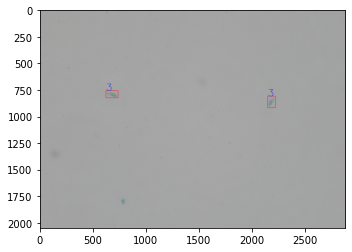

In [8]:
train_df2 = train_df[train_df['id'] == '813.png']
show_df(train_df2)

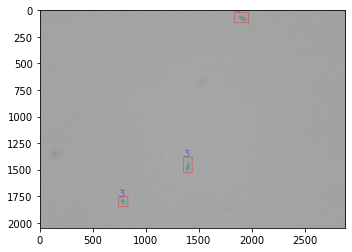

In [9]:
train_df2 = train_df[train_df['id'] == '814.png']
show_df(train_df2)

In [28]:
train_df2 =  train_df[train_df['label_set'].apply(lambda x:7 in x)]
train_df2

,id,label,bbox,label_set,label_len
29,723.png,"[7, 5]","[[28, 334, 192, 493], [2747, 1902, 2864, 2018]]","{5, 7}",2
44,682.png,"[7, 7, 7, 7, 5, 5, 7, 7, 7, 5, 5]","[[1374, 1107, 1549, 1283], [841, 1545, 951, 16...","{5, 7}",2
45,712.png,"[7, 7, 7, 5, 5]","[[719, 1169, 844, 1299], [866, 1330, 1003, 148...","{5, 7}",2
49,677.png,[7],"[[1564, 1290, 1754, 1465]]",{7},1
50,750.png,[7],"[[319, 729, 444, 909]]",{7},1
...,...,...,...,...,...
489,708.png,"[5, 5, 5, 7, 5]","[[1704, 624, 1823, 758], [1961, 523, 2148, 712...","{5, 7}",2
492,756.png,[7],"[[926, 1450, 1163, 1678]]",{7},1
529,664.png,"[7, 7]","[[36, 124, 204, 334], [323, 630, 483, 782]]",{7},1
533,659.png,[7],"[[807, 979, 1022, 1178]]",{7},1


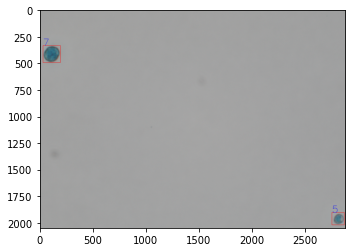

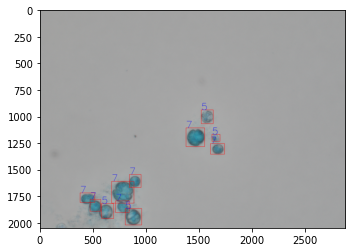

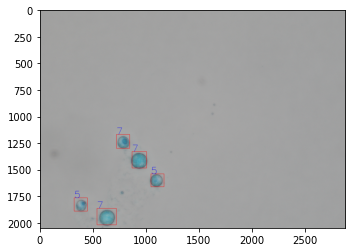

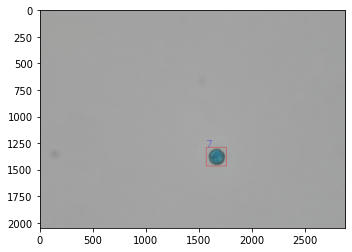

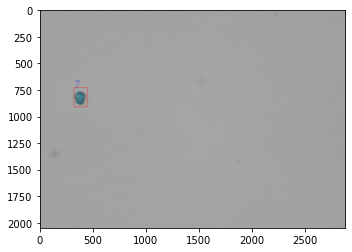

...

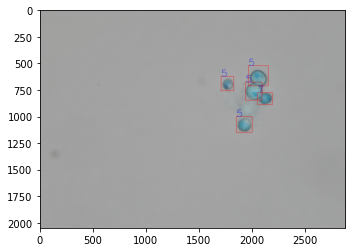

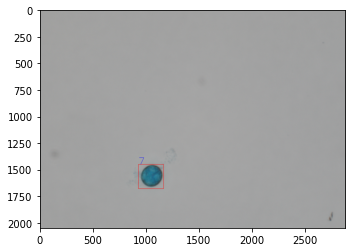

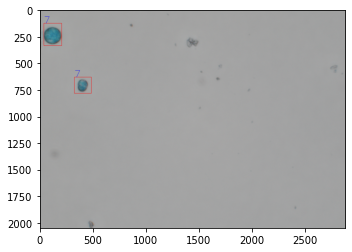

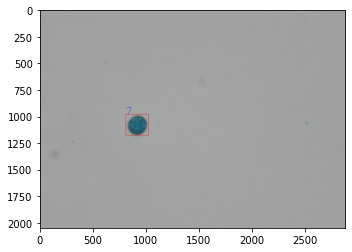

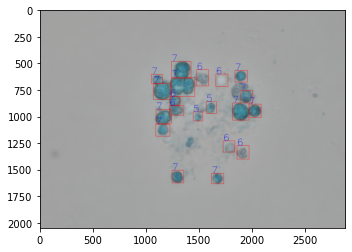

In [32]:
# train_df2 = train_df[train_df['label_set']=={4}]
train_df2 =  train_df[train_df['label_set'].apply(lambda x:7 in x)]
show_df(train_df2)

# 查看验证集输出和原始效果

# 显示测试集图片

In [35]:
def show_df(train_df):
    for row in train_df:
        data = cv2.imread(data_path + '/'+row)
        plt.imshow(data)
        plt.show()

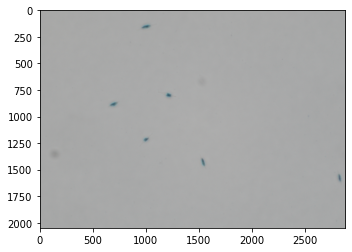

In [38]:
data_train = cv2.imread('../input/training_set/train/images/430.png')
plt.imshow(data_train)

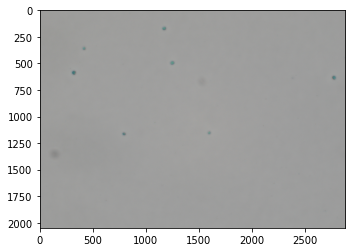

In [43]:
data_train = cv2.imread('../input/test_images/images/test4.png')
plt.imshow(data_train)

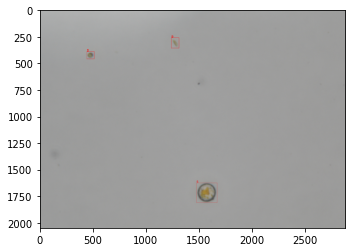

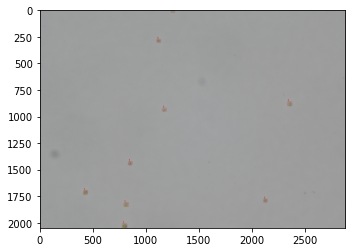

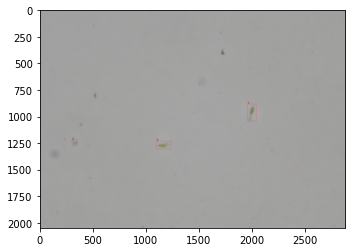

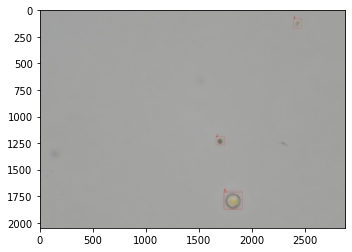

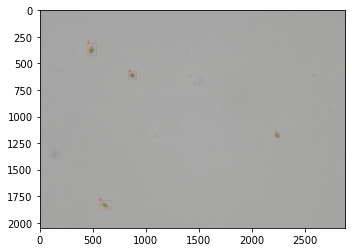

...

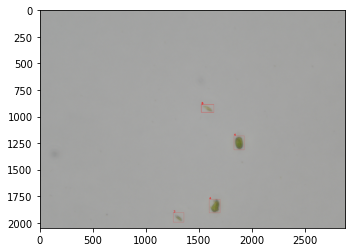

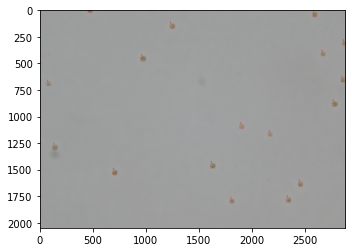

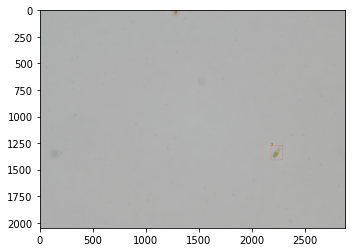

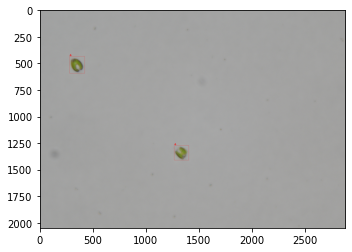

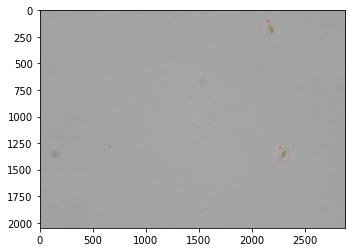

KeyboardInterrupt: 

In [36]:
show_df(path_base)

In [37]:
len(path_base)

430

In [34]:
data_path = '../work/plot_result/'
path_base = os.listdir(data_path)
path_base

['test353.png',
 'test379.png',
 'test408.png',
 'test239.png',
 'test86.png',
 'test171.png',
 'test359.png',
 'test114.png',
 'test309.png',
 'test336.png',
 'test378.png',
 'test235.png',
 'test270.png',
 'test249.png',
 'test180.png',
 'test385.png',
 'test97.png',
 'test113.png',
 'test381.png',
 'test394.png',
 'test182.png',
 'test185.png',
 'test88.png',
 'test147.png',
 'test169.png',
 'test361.png',
 'test228.png',
 'test60.png',
 'test205.png',
 'test297.png',
 'test77.png',
 'test350.png',
 'test288.png',
 'test112.png',
 'test94.png',
 'test300.png',
 'test356.png',
 'test419.png',
 'test49.png',
 'test343.png',
 'test92.png',
 'test387.png',
 'test213.png',
 'test389.png',
 'test194.png',
 'test209.png',
 'test372.png',
 'test181.png',
 'test268.png',
 'test220.png',
 'test327.png',
 'test18.png',
 'test100.png',
 'test166.png',
 'test66.png',
 'test399.png',
 'test90.png',
 'test137.png',
 'test315.png',
 'test393.png',
 'test151.png',
 'test58.png',
 'test370.png',
 'te